## Generate competition submission

In [1]:
INPUT_DIR = '../../input/kaggle-sea-lion/'
OUTPUT_DIR = '../../output/kaggle-sea-lion/20/'

IMAGE_DIMS = (42,42,3)
LABEL_DIMS = (6,)
LOAD_WEIGHTS_FILE = INPUT_DIR + '05/weights-medium1-42x42-0.94.h5'
LOAD_MODEL_FILE = None
DEBUG = True
IMAGE_SLICE = slice(1400,1800)
IMAGE_SLICE = slice(0,99999)

NR_SHARDS = 4
RECREATE_OUTPUT = True

In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt
import sklearn
import os
import glob
import cv2
from multiprocessing import Pool
import multiprocessing

from modules.logging import logger
import modules.utils as utils
from modules.utils import Timer
import modules.logging as logging
import modules.cnn as cnn
import modules.lions as lions
import modules.shards as shards
import modules.objectdetect as objectdetect

Using TensorFlow backend.


## Classify and count lions on each image

### Find lions on all images

In [3]:
#from MismatchedTrainImages.txt
MISMATCHED = [3, 7, 9, 21, 30, 34, 71, 81, 89, 97, 151, 184, 215, 234, 242, 268, 290, 311, 331, 344, 380, 384, 406, 421, 469, 475, 490, 499, 507, 530, 531, 605, 607, 614, 621, 638, 644, 687, 712, 721, 767, 779, 781, 794, 800, 811, 839, 840, 869, 882, 901, 903, 905, 909, 913, 927, 946]
FORCE_IMAGES = [42]
FORCE_IMAGES = None

In [4]:
def process_shard_lions(shard_group, shard_id):
    t = Timer('PROCESSING SHARD {}'.format(shard_id))

    output_dir = shard_group.shard_dir(shard_id)
    logging.setup_file_logger(output_dir + 'out.log')
    
    logger.info('Load CNN model')
    #lion simple cnn forward time: ~10ms
    print(LOAD_WEIGHTS_FILE)
    model = lions.convnet_medium1_lion_keras(IMAGE_DIMS)
    model.load_weights(LOAD_WEIGHTS_FILE)    

    #DECLARE FUNCTIONS INSIDE PROCESS INSTANCE
    """ Returns (score, label) """
    def evaluate_region_all_classes(region_img):
        y_pred = model.predict(np.array([region_img]))
        ylp = utils.onehot_to_label(np.array(y_pred))
        return y_pred[0][ylp[0]], ylp[0]

    
    def detect_lions(image, evaluate_function):
        #search for lions
        region_generator = objectdetect.sliding_window_generator(image, step=(19,19), window=IMAGE_DIMS, pyramid_max_layers=1)
        detections, imgs = objectdetect.evaluate_regions(region_generator, evaluate_function, filter_score_min=0.97, 
                                                         filter_labels=(0,1,2,3,4), apply_non_max_suppression=True, 
                                                         supression_overlap_threshold=0.1, threads=None)
        #calculate detection class distribution
        detected_lions = np.zeros(LABEL_DIMS[0]-1, dtype='int')
        for detection in detections:
            label = int(detection[5])
            detected_lions[label] += 1 

        if(DEBUG):
            def detection_to_colortext(detection):
                score = detection[4]
                text = str(int(detection[5])) + ' ' + '{0:.2f}'.format(score)
                c = int(score*255)
                return (0,0,c), text

            img2 = image.copy()
            objectdetect.draw_detections(detections, img2, detection_to_colortext)
            utils.show_image(img2, size=60, is_bgr=True)
    #        patches = objectdetect.extract_patches(detections, img)
    #        utils.show_images(patches[0:50], size=2, cols=10, is_bgr=True)   

        return detected_lions.tolist()

    if(shard_group.shard_done(shard_id)):
        logger.warning('shard {} already processed. Skipping'.format(shard_id))

    else:
        image_paths = shard_group.shard_items(shard_id)

        total_detected_lions = []

        for image_path in image_paths:
            base = os.path.basename(image_path)
            fn = os.path.splitext(base)
            if(fn[1]!='.jpg'):
                logger.info('ignoring non jpg image. filename=' + base)
                continue

            train_id = int(fn[0])

            if(FORCE_IMAGES!=None and train_id not in FORCE_IMAGES):
                continue

            t = Timer('processing photo ' + image_path)
            image_raw = cv2.imread(image_path)
            image_raw = image_raw[IMAGE_SLICE]
            detected_lions = detect_lions(image_raw, evaluate_region_all_classes)
            logger.info('image ' + str(train_id))
            logger.info('total detections: ' + str(np.sum(np.array(detected_lions))))
            logger.info('class detections: ' + str(detected_lions))
            total_detected_lions += [[train_id] + detected_lions]
            t.stop()

        logger.info('GENERATE SUBMISSION FILE')
        submission_file = output_dir + 'submission.csv'
        df = pd.DataFrame(total_detected_lions, columns=('test_id','adult_males','subadult_males','adult_females','juveniles','pups'))
        df.to_csv(submission_file, index=False)

        logger.info('detection result exported to ' + submission_file)        
        shard_group.mark_done(shard_id)

        t.stop()


In [5]:
logger.info('==== PROCESSING SHARDS IN PARALLEL ====')

logger.info('preparing shards')
images_dir = INPUT_DIR + "Train/"
image_paths = [images_dir+n for n in os.listdir(images_dir)]

shard_group = shards.ShardGroup(image_paths, NR_SHARDS, OUTPUT_DIR, recreate_shards_dir=RECREATE_OUTPUT)

2017-06-07 08:51:14,871 INFO ==== PROCESSING SHARDS IN PARALLEL ====
2017-06-07 08:51:14,873 INFO preparing shards


2017-06-07 08:51:14,905 INFO Using 4 parallel tasks
2017-06-07 08:51:16,984 INFO > [started] PROCESSING SHARD 3...
2017-06-07 08:51:16,995 INFO Load CNN model


../../input/kaggle-sea-lion/05/weights-medium1-42x42-0.94.h5


/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:69: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(64, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:71: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(128, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:73: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(256, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(256, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascienc

(400, 4992, 3)


2017-06-07 08:51:17,728 INFO pyramid layer=0 image=(400, 4992, 3) scale=1
2017-06-07 08:51:17,730 INFO > [started] sliding_window...


38/400 [==>.......................] 9% 3s sliding window

2017-06-07 08:51:21,989 INFO > [started] PROCESSING SHARD 4...
2017-06-07 08:51:22,000 INFO Load CNN model


../../input/kaggle-sea-lion/05/weights-medium1-42x42-0.94.h5


/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:69: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(64, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:71: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(128, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:73: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(256, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(256, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascienc

57/400 [====>.....................] 14% 5s remaining=30s sliding window

2017-06-07 08:51:23,990 INFO > [started] PROCESSING SHARD 2...
2017-06-07 08:51:24,001 INFO Load CNN model


../../input/kaggle-sea-lion/05/weights-medium1-42x42-0.94.h5


/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:69: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(64, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:71: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(128, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:73: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(256, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(256, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascienc

76/400 [=====>....................] 19% 6s remaining=29s sliding window

2017-06-07 08:51:24,635 INFO found 5 items for shard 2
2017-06-07 08:51:24,650 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/44.jpg...
2017-06-07 08:51:24,982 INFO > [started] PROCESSING SHARD 1...
2017-06-07 08:51:24,994 INFO Load CNN model


../../input/kaggle-sea-lion/05/weights-medium1-42x42-0.94.h5


/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:69: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(64, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(64, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:71: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(128, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(128, (3, 3), activation='relu', padding='same', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:73: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(256, (3, 3), kernel_initializer="glorot_uniform", padding="same", activation="relu")`
  model.add(convolutional.Conv2D(256, (3, 3), activation='relu', padding='same', init='glorot_uniform'))


(400, 4992, 3)


2017-06-07 08:51:25,178 INFO pyramid layer=0 image=(400, 4992, 3) scale=1
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:78: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(1024, kernel_initializer="glorot_uniform", activation="relu")`
  model.add(core.Dense(1024, activation='relu', init='glorot_uniform'))
2017-06-07 08:51:25,181 INFO > [started] sliding_window...


0/400 [>.........................] 0% 0s sliding window

/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:80: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(1024, kernel_initializer="glorot_uniform", activation="relu")`
  model.add(core.Dense(1024, activation='relu', init='glorot_uniform'))
/notebooks/datascience-snippets/kaggle-sea-lion/modules/lions.py:82: UserWarning: Update your `Dense` call to the Keras 2 API: `Dense(6, kernel_initializer="glorot_uniform", activation="softmax")`
  model.add(core.Dense(6, activation='softmax', init='glorot_uniform'))
2017-06-07 08:51:25,664 INFO found 3 items for shard 1
2017-06-07 08:51:25,666 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/43.jpg...


(400, 5616, 3)


2017-06-07 08:51:26,115 INFO pyramid layer=0 image=(400, 5616, 3) scale=1
2017-06-07 08:51:26,127 INFO > [started] sliding_window...


399/400 [=========================>] 99% 54s remaining=0s sliding windoww

2017-06-07 08:52:12,553 INFO > [done]    sliding_window (54822.809 ms)
2017-06-07 08:52:12,571 INFO > [started] non_max_suppression. boxes=0...
2017-06-07 08:52:12,586 INFO > [done]    non_max_suppression. boxes=0 (14.799 ms)


285/400 [==================>.......] 71% 48s remaining=19s sliding window

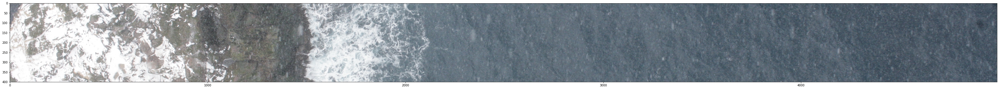

2017-06-07 08:52:15,260 INFO image 49
2017-06-07 08:52:15,288 INFO total detections: 0
2017-06-07 08:52:15,298 INFO class detections: [0, 0, 0, 0, 0]
2017-06-07 08:52:15,305 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/49.jpg (57872.608 ms)
2017-06-07 08:52:15,320 INFO ignoring non jpg image. filename=train.csv
2017-06-07 08:52:15,323 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/45.jpg...


(400, 4992, 3)


2017-06-07 08:52:15,811 INFO pyramid layer=0 image=(400, 4992, 3) scale=1
2017-06-07 08:52:15,821 INFO > [started] sliding_window...


399/400 [=========================>] 99% 62s remaining=0s sliding windoww

2017-06-07 08:52:27,649 INFO > [done]    sliding_window (62467.729 ms)
2017-06-07 08:52:27,660 INFO > [started] non_max_suppression. boxes=53124...
2017-06-07 08:52:27,895 INFO > [done]    non_max_suppression. boxes=53124 (235.438 ms)


76/400 [=====>....................] 19% 13s remaining=58s sliding windoww

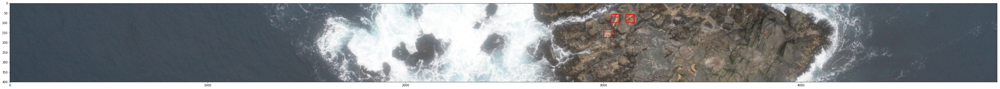

2017-06-07 08:52:31,183 INFO image 44
2017-06-07 08:52:31,187 INFO total detections: 3
2017-06-07 08:52:31,194 INFO class detections: [3, 0, 0, 0, 0]
2017-06-07 08:52:31,196 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/44.jpg (66545.884 ms)
2017-06-07 08:52:31,207 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/47.jpg...


95/400 [======>...................] 23% 16s remaining=52s sliding window

2017-06-07 08:52:32,249 INFO pyramid layer=0 image=(400, 5616, 3) scale=1
2017-06-07 08:52:32,254 INFO > [started] sliding_window...


399/400 [=========================>] 99% 69s remaining=0s sliding windoww

2017-06-07 08:52:35,689 INFO > [done]    sliding_window (69562.206 ms)
2017-06-07 08:52:35,692 INFO > [started] non_max_suppression. boxes=1790092...


95/400 [======>...................] 23% 16s remaining=51s sliding windoww

2017-06-07 08:52:48,331 INFO > [done]    non_max_suppression. boxes=1790092 (12639.177 ms)


209/400 [=============>............] 52% 32s remaining=30s sliding window

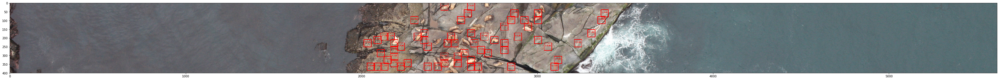

2017-06-07 08:52:51,097 INFO image 43
2017-06-07 08:52:51,112 INFO total detections: 63
2017-06-07 08:52:51,129 INFO class detections: [63, 0, 0, 0, 0]
2017-06-07 08:52:51,147 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/43.jpg (85480.849 ms)
2017-06-07 08:52:51,154 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/46.jpg...


228/400 [==============>...........] 56% 35s remaining=26s sliding window(400, 5616, 3)


2017-06-07 08:52:51,922 INFO pyramid layer=0 image=(400, 5616, 3) scale=1
2017-06-07 08:52:51,931 INFO > [started] sliding_window...


399/400 [=========================>] 99% 57s remaining=0s sliding windoww

2017-06-07 08:53:13,007 INFO > [done]    sliding_window (57185.733 ms)
2017-06-07 08:53:13,016 INFO > [started] non_max_suppression. boxes=1952795...


209/400 [=============>............] 52% 34s remaining=31s sliding window

2017-06-07 08:53:27,446 INFO > [done]    non_max_suppression. boxes=1952795 (14429.624 ms)


228/400 [==============>...........] 56% 37s remaining=28s sliding window

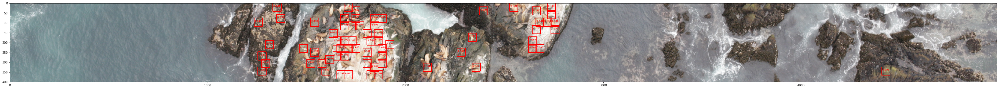

2017-06-07 08:53:30,397 INFO image 45
2017-06-07 08:53:30,403 INFO total detections: 66
2017-06-07 08:53:30,418 INFO class detections: [66, 0, 0, 0, 0]
2017-06-07 08:53:30,431 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/45.jpg (75107.594 ms)
2017-06-07 08:53:30,445 INFO GENERATE SUBMISSION FILE
2017-06-07 08:53:30,478 INFO detection result exported to ../../output/kaggle-sea-lion/20/3/submission.csv
2017-06-07 08:53:30,507 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/45.jpg (75184.215 ms)


399/400 [=========================>] 99% 59s remaining=0s sliding window

2017-06-07 08:53:31,438 INFO > [done]    sliding_window (59183.144 ms)
2017-06-07 08:53:31,448 INFO > [started] non_max_suppression. boxes=363322...


247/400 [===============>..........] 61% 40s remaining=25s sliding window

2017-06-07 08:53:33,013 INFO > [done]    non_max_suppression. boxes=363322 (1565.047 ms)


266/400 [=================>........] 66% 43s remaining=21s sliding window

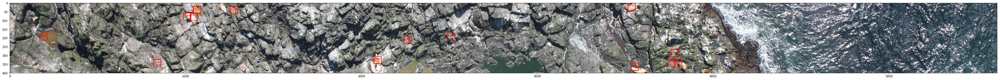

2017-06-07 08:53:35,552 INFO image 47
2017-06-07 08:53:35,556 INFO total detections: 14
2017-06-07 08:53:35,565 INFO class detections: [14, 0, 0, 0, 0]
2017-06-07 08:53:35,570 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/47.jpg (64363.195 ms)
2017-06-07 08:53:35,572 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/48.jpg...


(400, 4992, 3)


2017-06-07 08:53:36,061 INFO pyramid layer=0 image=(400, 4992, 3) scale=1
2017-06-07 08:53:36,064 INFO > [started] sliding_window...


399/400 [=========================>] 99% 58s remaining=0s sliding windoww

2017-06-07 08:53:50,087 INFO > [done]    sliding_window (58156.593 ms)
2017-06-07 08:53:50,091 INFO > [started] non_max_suppression. boxes=1624487...


152/400 [==========>...............] 38% 19s remaining=31s sliding window

2017-06-07 08:53:56,347 INFO > [done]    non_max_suppression. boxes=1624487 (6256.257 ms)


171/400 [===========>..............] 42% 21s remaining=28s sliding window

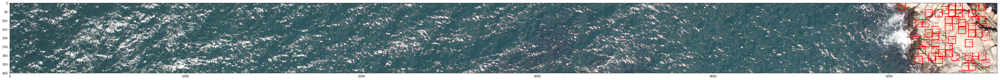

2017-06-07 08:53:58,336 INFO image 46
2017-06-07 08:53:58,338 INFO total detections: 49
2017-06-07 08:53:58,344 INFO class detections: [49, 0, 0, 0, 0]
2017-06-07 08:53:58,346 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/46.jpg (67191.352 ms)
2017-06-07 08:53:58,347 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/41.jpg...


(400, 4992, 3)


2017-06-07 08:53:58,680 INFO pyramid layer=0 image=(400, 4992, 3) scale=1
2017-06-07 08:53:58,688 INFO > [started] sliding_window...


399/400 [=========================>] 99% 44s remaining=0s sliding windoww

2017-06-07 08:54:21,113 INFO > [done]    sliding_window (45049.373 ms)
2017-06-07 08:54:21,117 INFO > [started] non_max_suppression. boxes=2828849...


323/400 [====================>.....] 80% 37s remaining=9s sliding windoww

2017-06-07 08:54:36,604 INFO > [done]    non_max_suppression. boxes=2828849 (15485.996 ms)


342/400 [=====================>....] 85% 40s remaining=6s sliding window

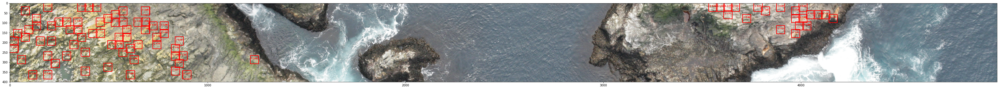

2017-06-07 08:54:38,930 INFO image 48
2017-06-07 08:54:38,946 INFO total detections: 87
2017-06-07 08:54:38,951 INFO class detections: [87, 0, 0, 0, 0]
2017-06-07 08:54:38,953 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/48.jpg (63380.846 ms)
2017-06-07 08:54:38,957 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/50.jpg...


(400, 4992, 3)


2017-06-07 08:54:39,284 INFO pyramid layer=0 image=(400, 4992, 3) scale=1
2017-06-07 08:54:39,286 INFO > [started] sliding_window...


399/400 [=========================>] 99% 42s remaining=0s sliding window

2017-06-07 08:54:41,066 INFO > [done]    sliding_window (42377.600 ms)
2017-06-07 08:54:41,069 INFO > [started] non_max_suppression. boxes=221691...


19/400 [=>........................] 4% 2s sliding window

2017-06-07 08:54:41,873 INFO > [done]    non_max_suppression. boxes=221691 (804.096 ms)


38/400 [==>.......................] 9% 4s sliding window

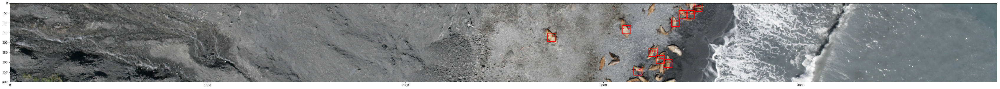

2017-06-07 08:54:44,356 INFO image 41
2017-06-07 08:54:44,361 INFO total detections: 10
2017-06-07 08:54:44,364 INFO class detections: [10, 0, 0, 0, 0]
2017-06-07 08:54:44,376 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/41.jpg (46028.363 ms)
2017-06-07 08:54:44,389 INFO GENERATE SUBMISSION FILE
2017-06-07 08:54:44,410 INFO detection result exported to ../../output/kaggle-sea-lion/20/1/submission.csv
2017-06-07 08:54:44,420 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/41.jpg (46072.098 ms)


399/400 [=========================>] 99% 32s remaining=0s sliding windoww

2017-06-07 08:55:11,810 INFO > [done]    sliding_window (32523.800 ms)
2017-06-07 08:55:11,813 INFO > [started] non_max_suppression. boxes=0...
2017-06-07 08:55:11,815 INFO > [done]    non_max_suppression. boxes=0 (2.260 ms)


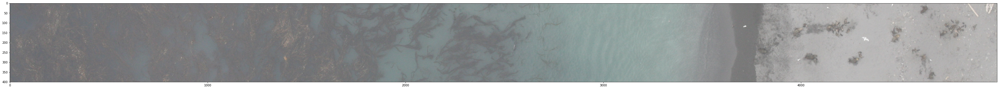

2017-06-07 08:55:13,980 INFO image 50
2017-06-07 08:55:13,985 INFO total detections: 0
2017-06-07 08:55:13,987 INFO class detections: [0, 0, 0, 0, 0]
2017-06-07 08:55:13,989 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/50.jpg (35032.231 ms)
2017-06-07 08:55:13,991 INFO > [started] processing photo ../../input/kaggle-sea-lion/Train/42.jpg...


(400, 4992, 3)


2017-06-07 08:55:14,264 INFO pyramid layer=0 image=(400, 4992, 3) scale=1
2017-06-07 08:55:14,266 INFO > [started] sliding_window...


399/400 [=========================>] 99% 32s remaining=0s sliding windoww

2017-06-07 08:55:46,959 INFO > [done]    sliding_window (32692.596 ms)
2017-06-07 08:55:46,961 INFO > [started] non_max_suppression. boxes=1378607...
2017-06-07 08:55:52,220 INFO > [done]    non_max_suppression. boxes=1378607 (5258.957 ms)


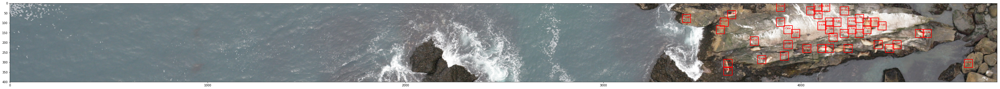

2017-06-07 08:55:54,310 INFO image 42
2017-06-07 08:55:54,312 INFO total detections: 43
2017-06-07 08:55:54,314 INFO class detections: [43, 0, 0, 0, 0]
2017-06-07 08:55:54,316 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/42.jpg (40324.926 ms)
2017-06-07 08:55:54,318 INFO GENERATE SUBMISSION FILE
2017-06-07 08:55:54,326 INFO detection result exported to ../../output/kaggle-sea-lion/20/2/submission.csv
2017-06-07 08:55:54,330 INFO > [done]    processing photo ../../input/kaggle-sea-lion/Train/42.jpg (40338.756 ms)
2017-06-07 08:55:54,520 INFO ==== ALL DONE ====


In [6]:
shard_group.start_processing(process_shard_lions, shard_ids=None, threads=-1)
logger.info('==== ALL DONE ====')

## Combine all shard results 

In [7]:
logger.info('COMBINING ALL SHARD RESULTS INTO ONE SUBMISSION FILE')

total_detected_lions = np.array([])
for sd in shard_group.shard_dirs():
    df = pd.read_csv(sd + 'submission.csv')
    if(len(total_detected_lions)>0):
        total_detected_lions = np.concatenate((total_detected_lions, df.as_matrix()))
    else:
        total_detected_lions = df.as_matrix()

submission_file = OUTPUT_DIR + 'submission-merged.csv'
df = pd.DataFrame(total_detected_lions, columns=('test_id','adult_males','subadult_males','adult_females','juveniles','pups'))
df = df.sort_values('test_id')
df.to_csv(submission_file, index=False)
logger.info('submission file merged')

2017-06-07 08:55:54,531 INFO COMBINING ALL SHARD RESULTS INTO ONE SUBMISSION FILE
2017-06-07 08:55:54,580 INFO submission file merged
